# Nome da empresa : MDC Hortifrut

# Ramo de Atuação : Alimentos

In [2]:
#importando as bibliotecas que serão utilizadas
import pandas as pd
import numpy as np
import math
import statistics
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import warnings
import missingno as msno
warnings.filterwarnings("ignore")

Matplotlib is building the font cache; this may take a moment.


In [3]:
df = pd.read_csv("../1_Bases_Originais/empresa2.csv", sep = ';')

In [4]:
df.shape #A tabela tem 63918 linhas e 5 colunas

(63918, 5)

In [5]:
#Procurando dados missing
df.isnull().sum()
#Temos bastante dados nulos, será preciso olhar na matrix para ver se há algum padrão
#nesses dados

renda      6433
compras    6290
idade      6370
scrcrdt    6406
sexo       6460
dtype: int64

<Axes: >

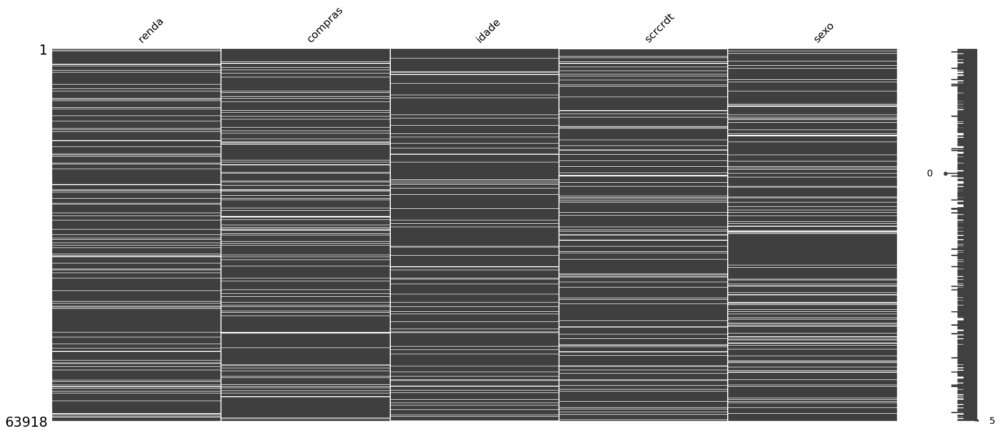

In [6]:
#Criando a matrix do dataframe
msno.matrix(df)
#Aparentemente não há nenhum tipo de padrão nas colunas

# Tratando MISSINGS

Imputando a mediana para variáveis continuas, e tratando variaveis categóricas

In [7]:
df.renda.fillna(df.renda.median(), inplace = True)
df.idade.fillna(df.idade.median(), inplace = True)
df.compras.fillna(df.compras.median(), inplace = True)
df.scrcrdt.fillna(df.scrcrdt.median(), inplace = True)

In [8]:
#Para a variável categória 'sexo' vamos procurar o valor mais frequente e atribuir este valor
#aos missings e tratar.
df.sexo.value_counts()

sexo
0.0    38219
1.0    19239
Name: count, dtype: int64

In [9]:
#O valor mais frequente é o sexo 0 - Feminino
#Vamos atribuir os missings a ele e tratar
df.sexo.fillna(0, inplace = True)

<Axes: >

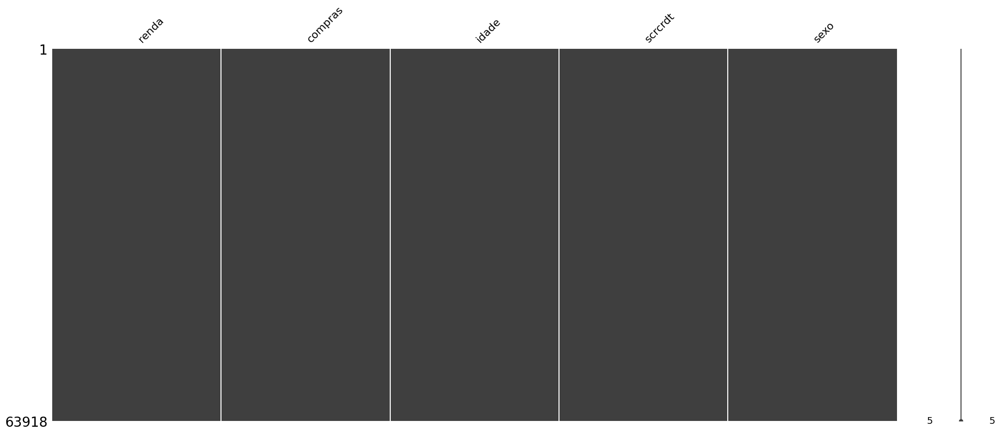

In [10]:
#Olhando a matrix agora
msno.matrix(df)
#Todos os Missings foram tratados

# Analisando Duplicados

In [11]:
#Vamos puxar a quatidade de valores duplicados da tabela para podermos tratalos
df.duplicated().sum()

603

In [12]:
#Agora vamos filtrar para exibir os duplicatos do DF
df.loc[df.duplicated() == True]


,renda,compras,idade,scrcrdt,sexo
264,5020.049965,4281.960658,41.0,392.0,0.0
265,5020.049965,4281.960658,41.0,392.0,0.0
570,5020.049965,4281.960658,41.0,392.0,0.0
690,5020.049965,4281.960658,41.0,392.0,0.0
850,5020.049965,4281.960658,41.0,392.0,0.0
...,...,...,...,...,...
62949,5020.049965,4281.960658,24.0,662.0,1.0
63293,5020.049965,4281.960658,24.0,662.0,1.0
63711,5020.049965,4281.960658,24.0,662.0,1.0
63772,5020.049965,4281.960658,24.0,662.0,1.0


In [13]:
#Dropando os valores duplicados
df = df.drop_duplicates()
#pronto

# Tratando Outliers

In [14]:
#Visualizando os valores Outliers para a coluna Renda
px.box(df.renda)
#A coluna Renda é uma variável continua, mas por se tratar de renda, os outliers devem ser levados em consideração.
#Visto que algumas pessoas podem ter uma renda muito alta e outras muito baixa.

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'variable=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa'},
              'name': '',
              'notched': False,
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'box',
              'x': array(['renda', 'renda', 'renda', ..., 'renda', 'renda', 'renda'], dtype=object),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([5441.81846595, 6033.03157924, 6117.68831424, ..., 4245.5368682 ,
                          5020.04996474, 4732.2837297 ]),
              'y0': ' ',
              'yaxis': 'y'}],
    'layout': {'boxmode': 'group',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'variable'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [ ]:
#Olhando os outliers da coluna compras
px.box(df.compras)

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'variable=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa'},
              'name': '',
              'notched': False,
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'box',
              'x': array(['compras', 'compras', 'compras', ..., 'compras', 'compras', 'compras'],
                         dtype=object),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([4371.21023323, 5113.74163491, 5090.21504606, ..., 3573.87350193,
                          3961.82495532, 3627.60998283]),
              'y0': ' ',
              'yaxis': 'y'}],
    'layout': {'boxmode': 'group',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'variable'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [15]:
#Olhando os Outliers da coluna idade
px.box(df.idade)
#Olhando essa Box, podemos concluir que as idades estão na media central de 47 anos e a pessoa mais velha tem
# 62 anos.

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'variable=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa'},
              'name': '',
              'notched': False,
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'box',
              'x': array(['idade', 'idade', 'idade', ..., 'idade', 'idade', 'idade'], dtype=object),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([41., 41., 41., ..., 24., 24., 47.]),
              'y0': ' ',
              'yaxis': 'y'}],
    'layout': {'boxmode': 'group',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'variable'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [16]:
#Ohando os outliers da coluna de crédito
px.box(df.scrcrdt)
#Aqui não tem outliers, visto em conta que o crédito funciona como o Serasa. O valor máximo seria Score 1000.
#todos os valores respeitam esse limite.

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'variable=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa'},
              'name': '',
              'notched': False,
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'box',
              'x': array(['scrcrdt', 'scrcrdt', 'scrcrdt', ..., 'scrcrdt', 'scrcrdt', 'scrcrdt'],
                         dtype=object),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([392., 392., 392., ..., 662., 662., 662.]),
              'y0': ' ',
              'yaxis': 'y'}],
    'layout': {'boxmode': 'group',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'variable'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [17]:
#Fazendo um agrupamento para checar se o outlier Compra tem haver com a Renda do cliente.
df.groupby(by=['renda', 'compras']).sum()

,,idade,scrcrdt,sexo
renda,compras,,,
3616.008674,4034.812282,47.0,614.0,0.0
3618.830366,3130.742216,24.0,662.0,1.0
3686.062745,3345.619361,47.0,445.0,0.0
3688.070487,3211.907183,32.0,614.0,0.0
3722.528932,3658.515602,47.0,107.0,0.0
...,...,...,...,...
6746.918486,4486.157227,62.0,648.0,1.0
6755.703365,5430.149273,49.0,988.0,0.0
6820.011781,5644.071487,41.0,392.0,0.0


In [18]:
#Aqui podemos ver que o valor em compras tem correlação com a Renda do cliente
#O cliente que tem a maior renda, consequentemente tem o maior valor em compras no hotifrut
#Há clientes que gastam mais do que ganham
df.loc[df.renda > 5525.08]

,renda,compras,idade,scrcrdt,sexo
1,6033.031579,5113.741635,41.0,392.0,0.0
2,6117.688314,5090.215046,41.0,392.0,0.0
5,5805.420660,4718.372918,41.0,392.0,0.0
6,6133.122755,4926.712098,41.0,392.0,0.0
7,5536.617748,4668.629839,41.0,392.0,0.0
...,...,...,...,...,...
59792,5609.355972,4281.960658,24.0,662.0,0.0
60526,5539.471748,4443.929961,24.0,662.0,1.0
60670,5547.287481,4367.884206,47.0,662.0,0.0
61744,5553.124974,4210.935131,24.0,662.0,1.0


In [19]:
df.loc[df.compras > 5441.561, 'compras'] = 5441.561
# Travando os dados outliers maiores que o valor máximo no valor máximo

In [20]:
df.loc[df.compras < 3203.568, 'compras'] = 3203.568
# Travando os dados outliers maiores que o valor mínimo no valor mínimo

In [21]:
px.box(df.compras)
# Conferindo se ainda existem outliers na coluna compras

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'variable=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa'},
              'name': '',
              'notched': False,
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'box',
              'x': array(['compras', 'compras', 'compras', ..., 'compras', 'compras', 'compras'],
                         dtype=object),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([4371.21023323, 5113.74163491, 5090.21504606, ..., 3573.87350193,
                          3961.82495532, 3627.60998283]),
              'y0': ' ',
              'yaxis': 'y'}],
    'layout': {'boxmode': 'group',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'variable'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [25]:
df.to_csv('../2_Bases_Tratadas/MDCHORTFRUIT.csv', sep=';')

In [22]:
df.columns

Index(['renda', 'compras', 'idade', 'scrcrdt', 'sexo'], dtype='object')

<Axes: xlabel='renda', ylabel='Count'>

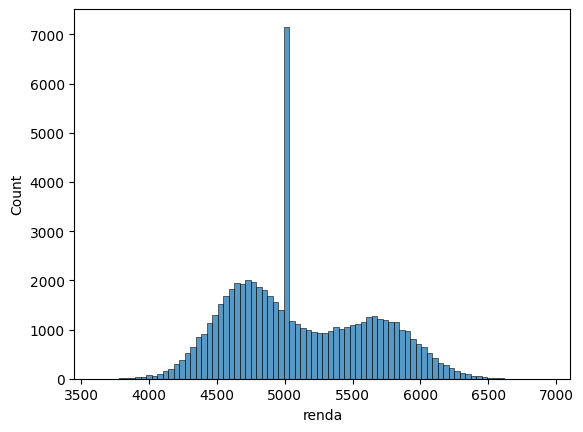

In [24]:
sns.histplot(df.renda)

In [40]:
px.scatter(df,x='renda', y='compras', color=df.sexo)

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed